# Spacial and Frequency Filtering

- **Questions**: [Here](../data/exercise_1/HW1.pdf)
- **Answer Set**: No. 01
- **Full Name**: Mohammad Hosein Nemati
- **Student Code**: `610300185`

---

## Basics

In this section we will done some basic steps:

### Libraries

Before begin, we must import these required libraries:

In [2]:
import warnings

import cv2 as cv
import numpy as np
import pandas as pd
import sklearn as sk
import matplotlib.pyplot as plt

import sklearn.utils as skutils
import sklearn.pipeline as skpipeline
import sklearn.preprocessing as skprocessing
import sklearn.model_selection as skselection
import sklearn.feature_extraction.text as sktext

warnings.filterwarnings("ignore", category=UserWarning)
sk.set_config(display="diagram")

---

## Problem 1

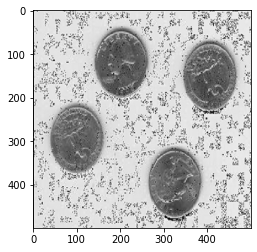

In [3]:
img = cv.imread("../lib/images/image1.jpg")
img = cv.cvtColor(img, cv.COLOR_BGR2RGB)

plt.imshow(img)
plt.show()

### (a)

In [4]:
print(f"Neighboring pixels difference: (x=5, y=5)")
print(f"")
print(f"Top: {img[5, 5] - img[5, 6]}")
print(f"Right: {img[5, 5] - img[6, 5]}")
print(f"Bottom: {img[5, 5] - img[5, 4]}")
print(f"Left: {img[5, 5] - img[4, 5]}")
print(f"---------------------------------------------")
print(f"Size: {img.size / 1024} KB")
print(f"Bytes: {img.size}")
print(f"Shape: {img.shape}")
print(f"---------------------------------------------")

Neighboring pixels difference: (x=5, y=5)

Top: [246 246 246]
Right: [253 253 253]
Bottom: [241 241 241]
Left: [2 2 2]
---------------------------------------------
Size: 732.421875 KB
Bytes: 750000
Shape: (500, 500, 3)
---------------------------------------------


### (b)

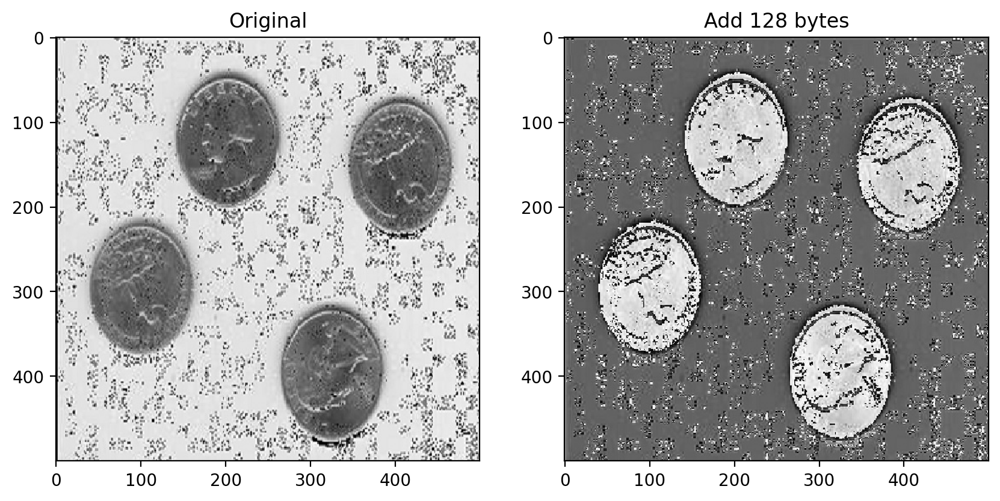

In [5]:
fig, plots = plt.subplots(nrows=1, ncols=2, figsize=(10, 5), dpi=200)

plots[0].imshow(img)
plots[0].set_title("Original")

plots[1].imshow(img + 128)
plots[1].set_title("Add 128 bytes")

plt.show()

### (c)

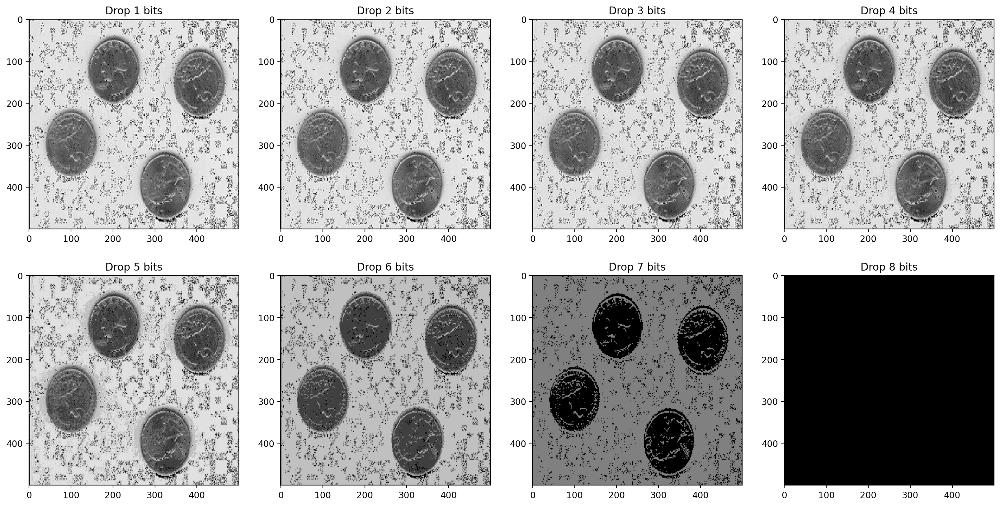

In [6]:
fig, plots = plt.subplots(nrows=2, ncols=4, figsize=(20, 10), dpi=200)
plots = plots.flatten()

for i in range(8):
    plots[i].imshow((img >> i + 1) << i + 1)
    plots[i].set_title(f"Drop {i+1} bits")

plt.show()

---

## Problem 2

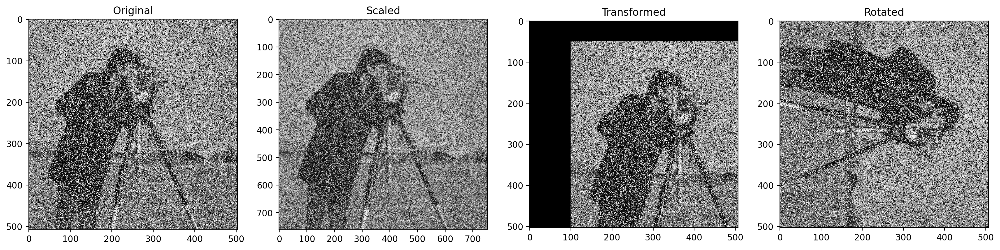

In [7]:
img = cv.imread("../lib/images/image2.jpg")
img = cv.cvtColor(img, cv.COLOR_BGR2RGB)

fig, plots = plt.subplots(nrows=1, ncols=4, figsize=(20, 5), dpi=200)

# Original Image
plots[0].imshow(img)
plots[0].set_title("Original")

# Scaled Image
plots[1].imshow(cv.resize(img, None, fx=1.5, fy=1.5))
plots[1].set_title("Scaled")

# Transformed Image
plots[2].imshow(cv.warpAffine(img, np.float32([[1, 0, 100], [0, 1, 50]]), (img.shape[0:2])))
plots[2].set_title("Transformed")

# Rotated Image
plots[3].imshow(cv.rotate(img, cv.ROTATE_90_CLOCKWISE))
plots[3].set_title("Rotated")

plt.show()

---

## Problem 3

### (a)

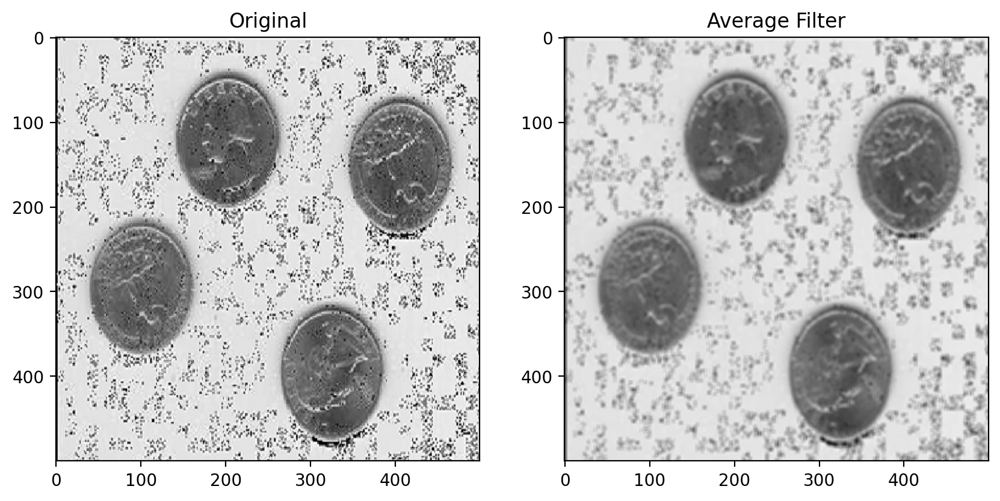

In [8]:
fig, plots = plt.subplots(nrows=1, ncols=2, figsize=(10, 5), dpi=200)

img = cv.imread("../lib/images/image1.jpg")
img = cv.cvtColor(img, cv.COLOR_BGR2RGB)

plots[0].imshow(img)
plots[0].set_title("Original")

plots[1].imshow(cv.filter2D(img, -1, np.ones((5, 5)) / 25))
plots[1].set_title("Average Filter")

plt.show()

### (b)

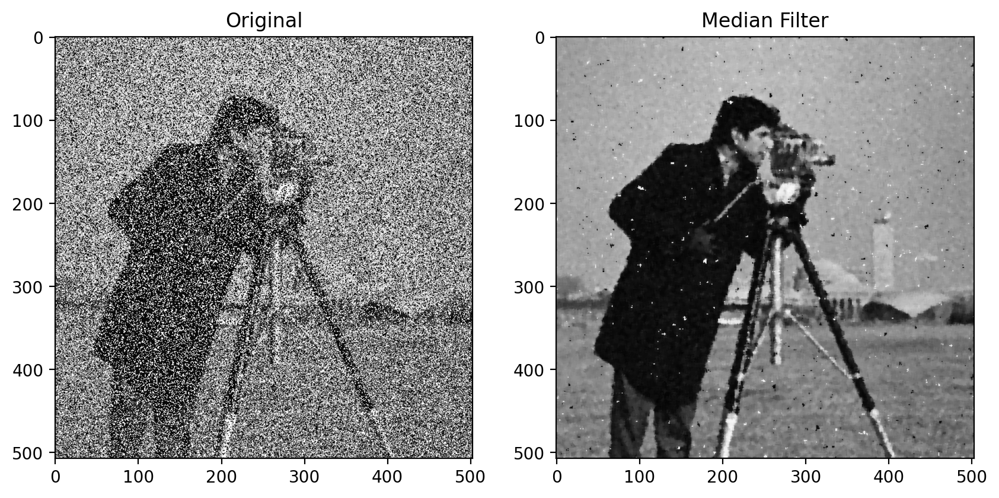

In [9]:
fig, plots = plt.subplots(nrows=1, ncols=2, figsize=(10, 5), dpi=200)

img = cv.imread("../lib/images/image2.jpg")
img = cv.cvtColor(img, cv.COLOR_BGR2RGB)

plots[0].imshow(img)
plots[0].set_title("Original")

plots[1].imshow(cv.medianBlur(img, 5))
plots[1].set_title("Median Filter")

plt.show()

### (c)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


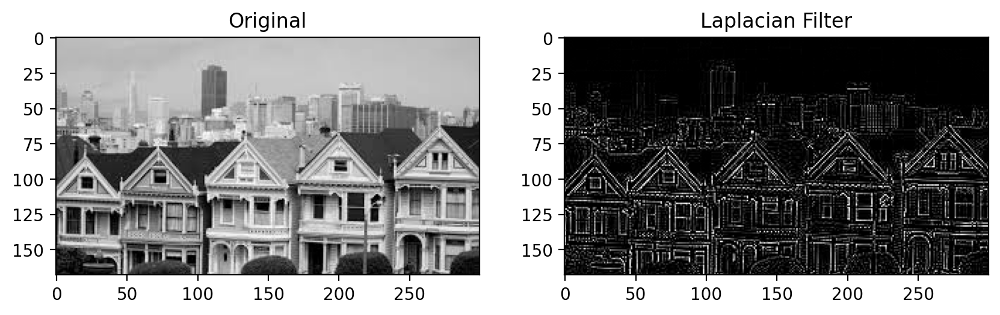

In [10]:
fig, plots = plt.subplots(nrows=1, ncols=2, figsize=(10, 5), dpi=200)

img = cv.imread("../lib/images/image3.jpg")
img = cv.cvtColor(img, cv.COLOR_BGR2RGB)

plots[0].imshow(img)
plots[0].set_title("Original")

plots[1].imshow(cv.Laplacian(img, cv.CV_16S, 5))
plots[1].set_title("Laplacian Filter")

plt.show()

### (d)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


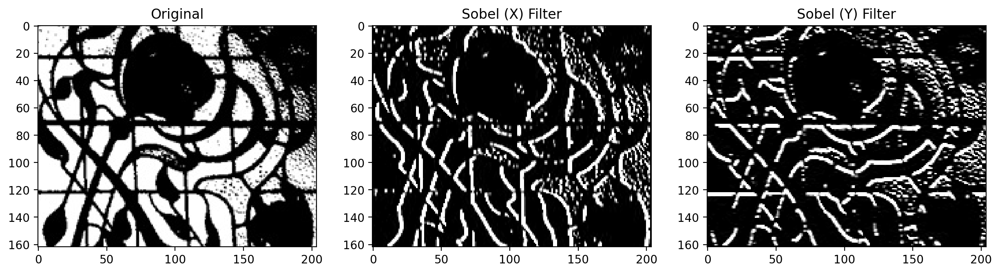

In [11]:
fig, plots = plt.subplots(nrows=1, ncols=3, figsize=(15, 5), dpi=200)

img = cv.imread("../lib/images/image4.jpg")
img = cv.cvtColor(img, cv.COLOR_BGR2RGB)

plots[0].imshow(img)
plots[0].set_title("Original")

plots[1].imshow(cv.Sobel(img, cv.CV_16S, 1, 0, 5))
plots[1].set_title("Sobel (X) Filter")

plots[2].imshow(cv.Sobel(img, cv.CV_16S, 0, 1, 5))
plots[2].set_title("Sobel (Y) Filter")

plt.show()

---

## Problem 4

### (a)

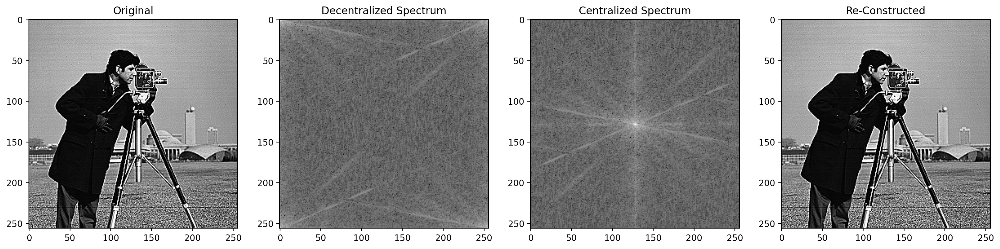

In [12]:
fig, plots = plt.subplots(nrows=1, ncols=4, figsize=(20, 5), dpi=200)

img = cv.imread("../lib/images/image5.jpg", cv.IMREAD_GRAYSCALE)
fft = np.fft.fft2(img)
fftimg = np.fft.ifft2(fft)

plots[0].imshow(img, cmap="gray")
plots[0].set_title("Original")

plots[1].imshow(np.log(1 + np.abs(fft)).astype(int), cmap="gray")
plots[1].set_title("Decentralized Spectrum")

plots[2].imshow(np.log(1 + np.fft.fftshift(np.abs(fft))).astype(int), cmap="gray")
plots[2].set_title("Centralized Spectrum")

plots[3].imshow(np.abs(fftimg), cmap="gray")
plots[3].set_title("Re-Constructed")

plt.show()

### (b)

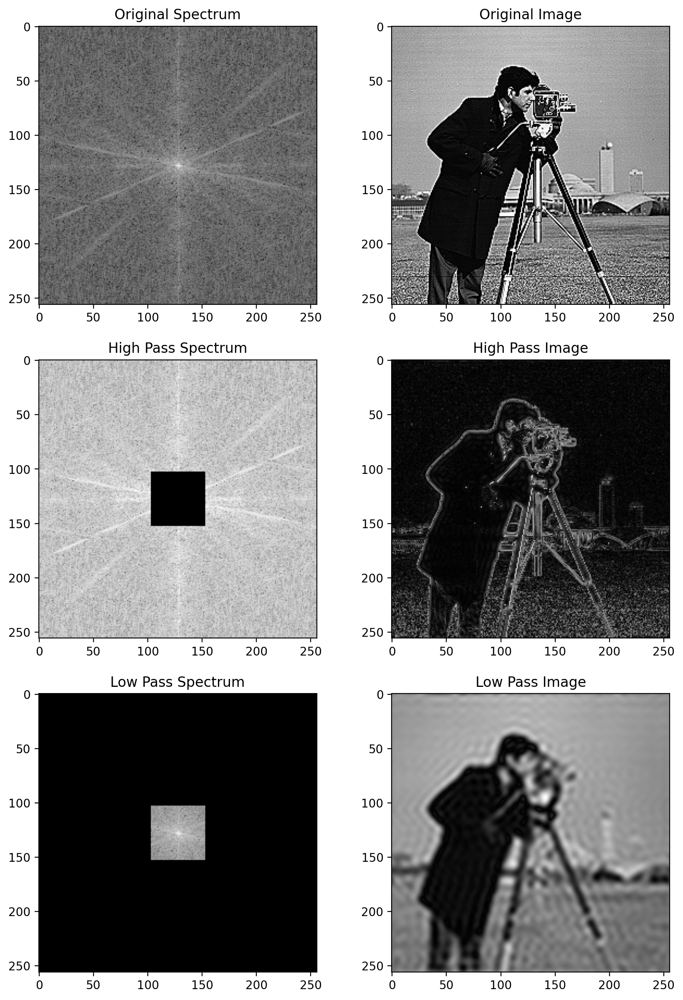

In [13]:
fig, plots = plt.subplots(nrows=3, ncols=2, figsize=(10, 15), dpi=200)

img = cv.imread("../lib/images/image5.jpg", cv.IMREAD_GRAYSCALE)

fft = np.fft.fftshift(np.fft.fft2(img))
plots[0][0].imshow(np.log(1 + np.abs(fft)).astype(int), cmap="gray")
plots[0][0].set_title("Original Spectrum")
plots[0][1].imshow(np.abs(np.fft.ifft2(np.fft.ifftshift(fft))), cmap="gray")
plots[0][1].set_title("Original Image")

hpfft = np.copy(fft)
x = int(hpfft.shape[0]/2)
y = int(hpfft.shape[1]/2)
hpfft[x-25:x+25, y-25:y+25] = 0
plots[1][0].imshow(np.log(1 + np.abs(hpfft)).astype(int), cmap="gray")
plots[1][0].set_title("High Pass Spectrum")
plots[1][1].imshow(np.abs(np.fft.ifft2(np.fft.ifftshift(hpfft))), cmap="gray")
plots[1][1].set_title("High Pass Image")

lpfft = fft - hpfft
plots[2][0].imshow(np.log(1 + np.abs(lpfft)).astype(int), cmap="gray")
plots[2][0].set_title("Low Pass Spectrum")
plots[2][1].imshow(np.abs(np.fft.ifft2(np.fft.ifftshift(lpfft))), cmap="gray")
plots[2][1].set_title("Low Pass Image")

plt.show()

### (c)

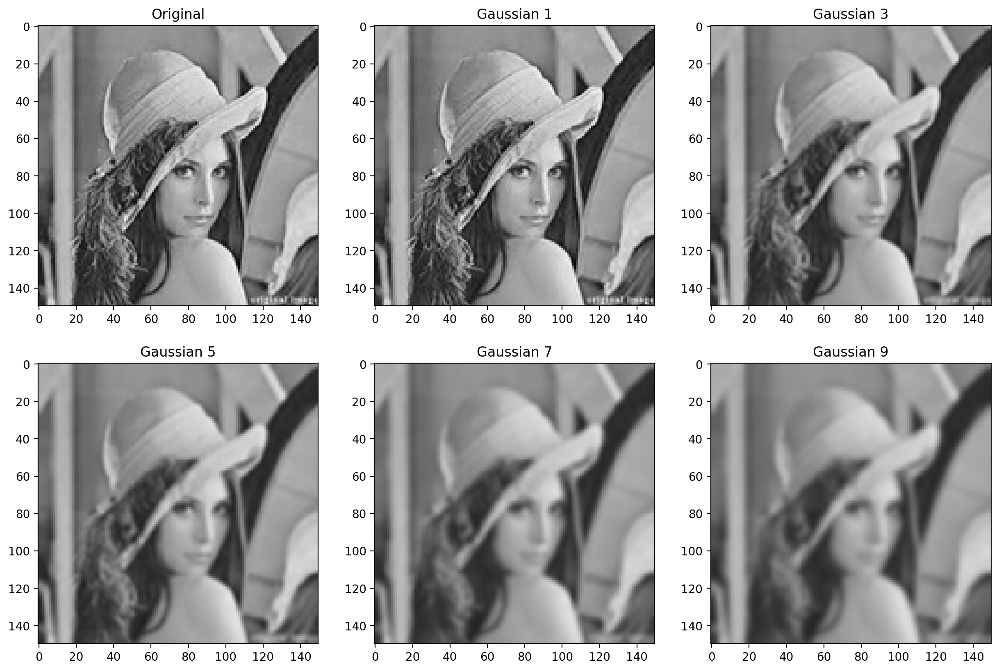

In [14]:
fig, plots = plt.subplots(nrows=2, ncols=3, figsize=(15, 10), dpi=200)
plots = plots.flatten()

img = cv.imread("../lib/images/image6.jpg")
img = cv.cvtColor(img, cv.COLOR_BGR2RGB)

plots[0].imshow(img)
plots[0].set_title("Original")

for i in range(1, 6):
    plots[i].imshow(cv.GaussianBlur(img, (i*2-1, i*2-1), 0))
    plots[i].set_title(f"Gaussian {i*2-1}")

plt.show()

---

## Problem 5

### (a)

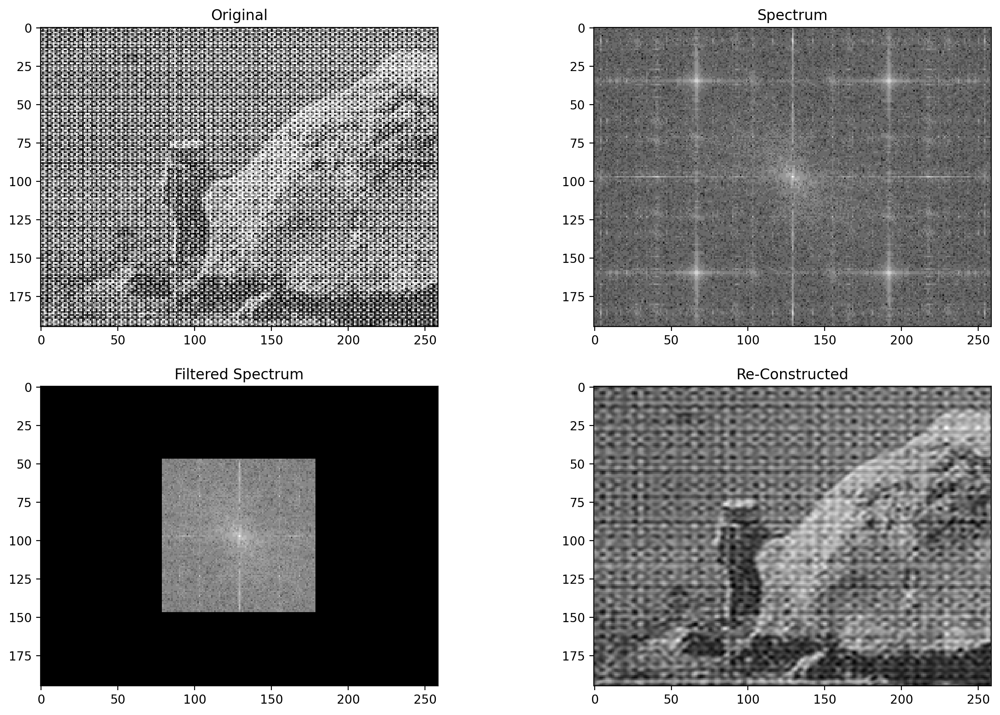

In [15]:
fig, plots = plt.subplots(nrows=2, ncols=2, figsize=(15, 10), dpi=200)
plots = plots.flatten()

img = cv.imread("../lib/images/1.jpg", cv.IMREAD_GRAYSCALE)

plots[0].imshow(img, cmap="gray")
plots[0].set_title("Original")

fft = np.fft.fftshift(np.fft.fft2(img))
plots[1].imshow(np.log(1 + np.abs(fft)).astype(int), cmap="gray")
plots[1].set_title("Spectrum")

x = int(fft.shape[0]/2)
y = int(fft.shape[1]/2)
fft2 = np.copy(fft)
fft2[x-50:x+50, y-50:y+50] = 0
fft = fft - fft2
plots[2].imshow(np.log(1 + np.abs(fft)).astype(int), cmap="gray")
plots[2].set_title("Filtered Spectrum")

plots[3].imshow(np.abs(np.fft.ifft2(np.fft.ifftshift(fft))), cmap="gray")
plots[3].set_title("Re-Constructed")

plt.show()

### (b)

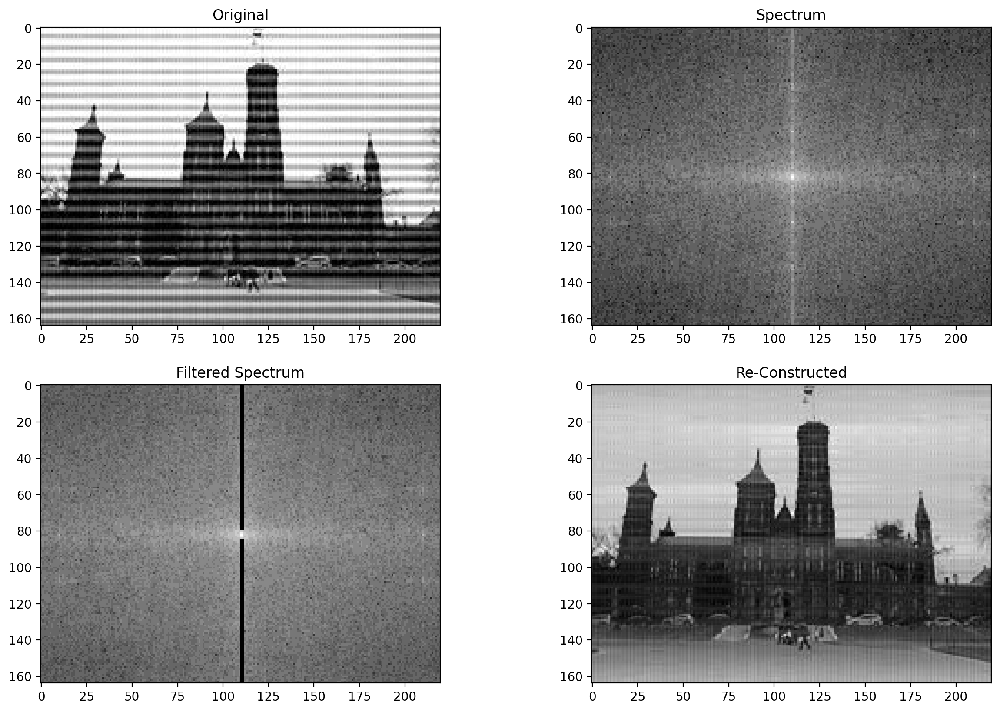

In [16]:
fig, plots = plt.subplots(nrows=2, ncols=2, figsize=(15, 10), dpi=200)
plots = plots.flatten()

img = cv.imread("../lib/images/2.jpg", cv.IMREAD_GRAYSCALE)

plots[0].imshow(img, cmap="gray")
plots[0].set_title("Original")

fft = np.fft.fftshift(np.fft.fft2(img))
plots[1].imshow(np.log(1 + np.abs(fft)).astype(int), cmap="gray")
plots[1].set_title("Spectrum")

fft[:80, 110:112] = fft[85:, 110:112] = 0
plots[2].imshow(np.log(1 + np.abs(fft)).astype(int), cmap="gray")
plots[2].set_title("Filtered Spectrum")

plots[3].imshow(np.abs(np.fft.ifft2(np.fft.ifftshift(fft))), cmap="gray")
plots[3].set_title("Re-Constructed")

plt.show()

### (c)

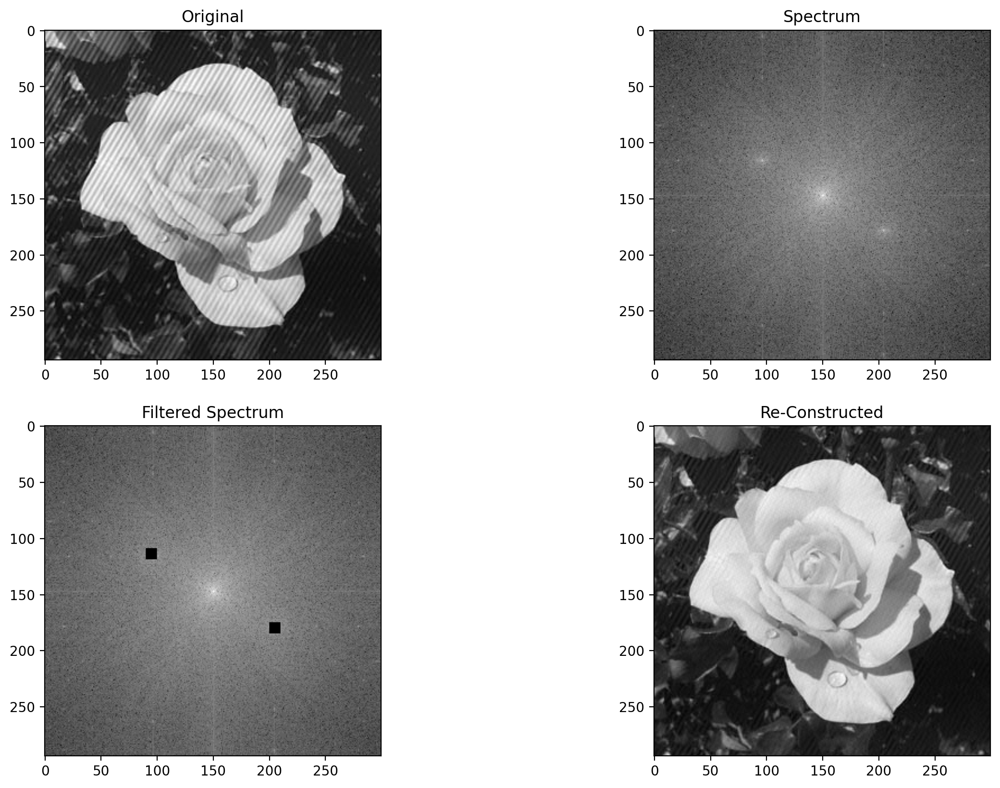

In [17]:
fig, plots = plt.subplots(nrows=2, ncols=2, figsize=(15, 10), dpi=200)
plots = plots.flatten()

img = cv.imread("../lib/images/3.jpg", cv.IMREAD_GRAYSCALE)

plots[0].imshow(img, cmap="gray")
plots[0].set_title("Original")

fft = np.fft.fftshift(np.fft.fft2(img))
plots[1].imshow(np.log(1 + np.abs(fft)).astype(int), cmap="gray")
plots[1].set_title("Spectrum")

fft[175:185, 200:210] = 0
fft[109:119, 90:100] = 0
plots[2].imshow(np.log(1 + np.abs(fft)).astype(int), cmap="gray")
plots[2].set_title("Filtered Spectrum")

plots[3].imshow(np.abs(np.fft.ifft2(np.fft.ifftshift(fft))), cmap="gray")
plots[3].set_title("Re-Constructed")

plt.show()

### (d)

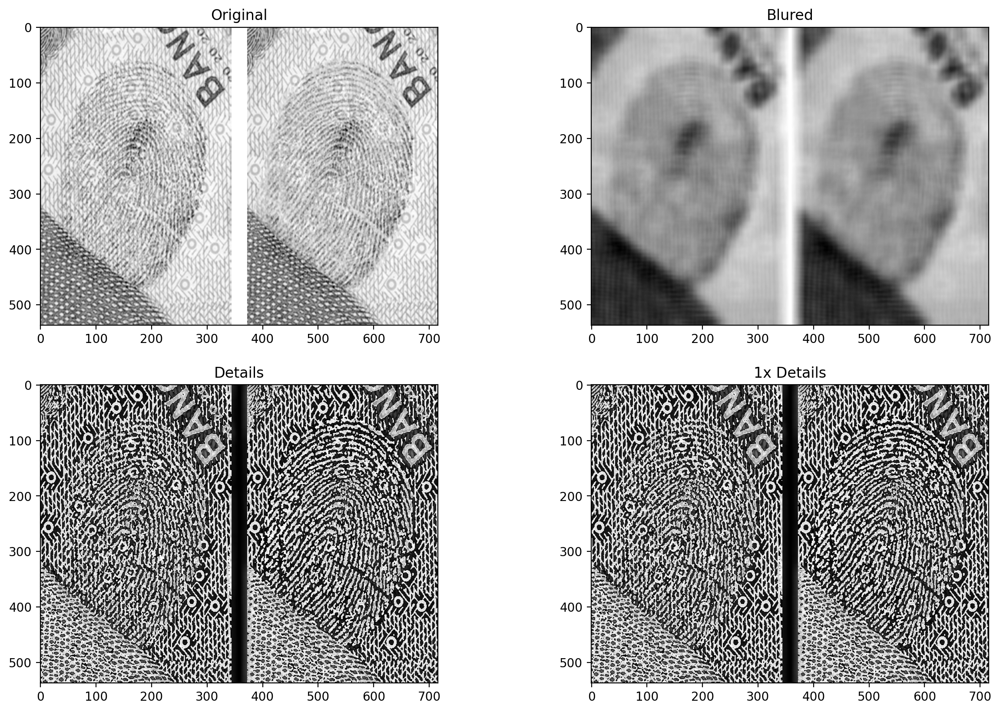

In [18]:
fig, plots = plt.subplots(nrows=2, ncols=2, figsize=(15, 10), dpi=200)
plots = plots.flatten()

img = cv.imread("../lib/images/4.jpg", cv.IMREAD_GRAYSCALE)

plots[0].imshow(img, cmap="gray")
plots[0].set_title("Original")

blured = cv.filter2D(img, -1, np.ones((25, 25)) / 25**2)
plots[1].imshow(blured, cmap="gray")
plots[1].set_title("Blured")

details = img - blured
plots[2].imshow(details, cmap="gray")
plots[2].set_title("Details")

plots[3].imshow(details, cmap="gray")
plots[3].set_title("1x Details")

plt.show()

---

## Problem 6

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


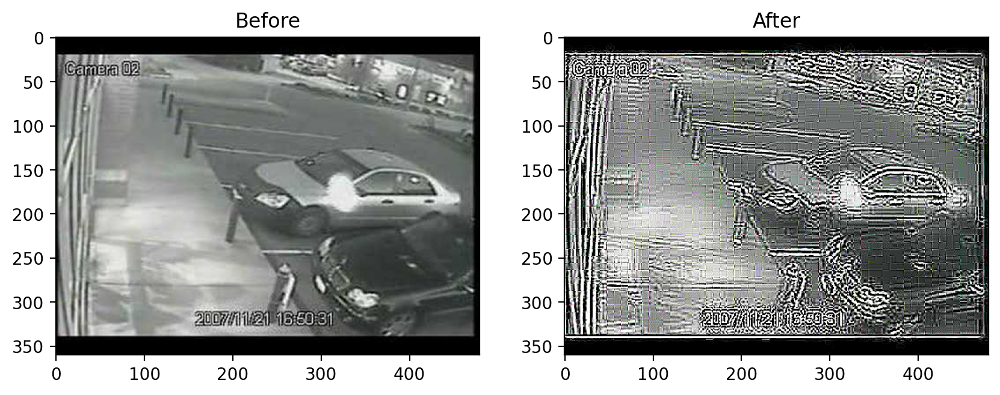

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


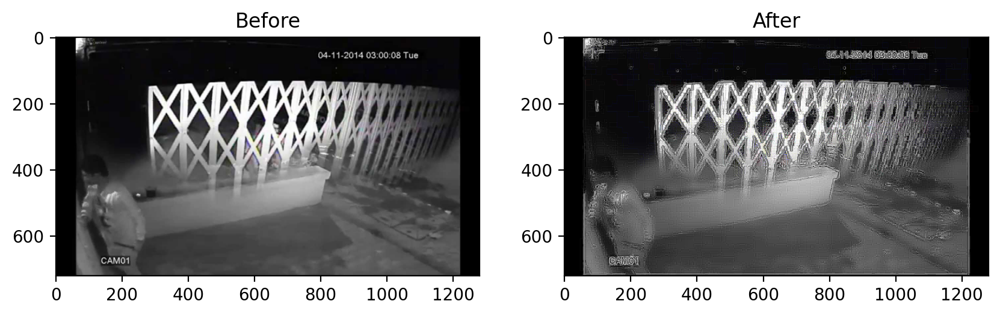

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


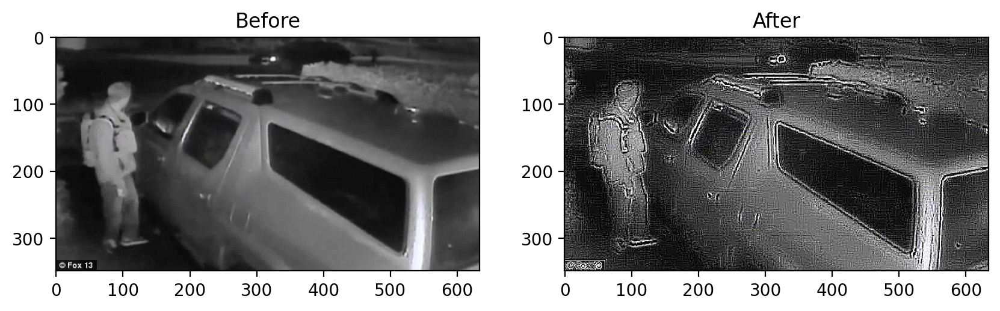

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


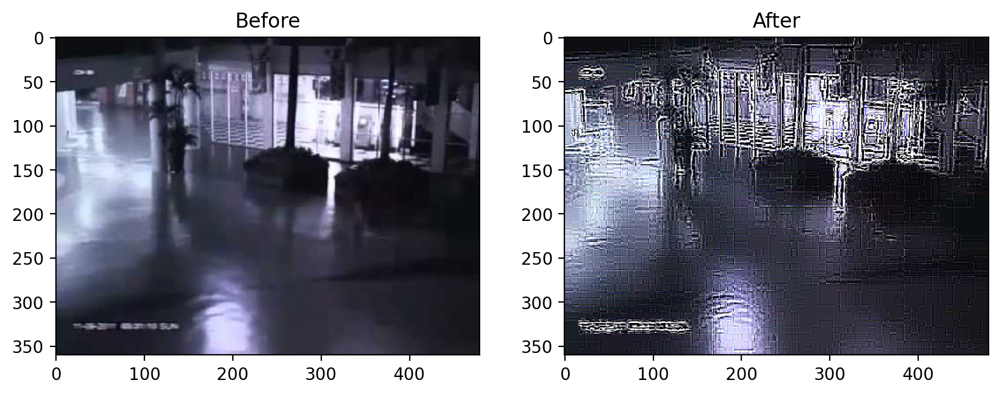

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


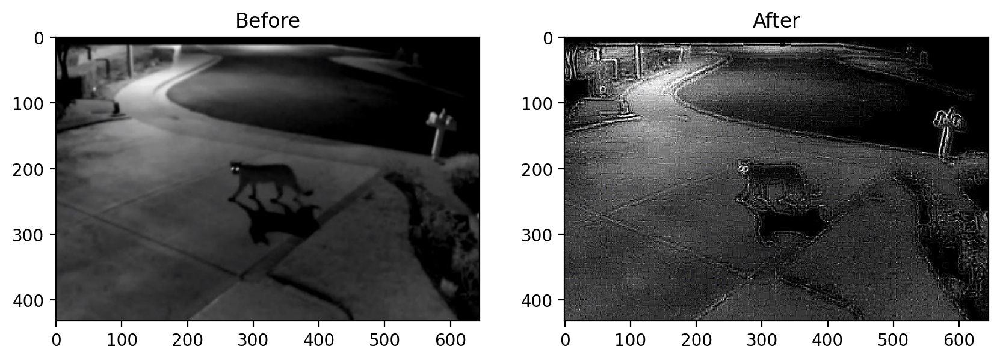

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


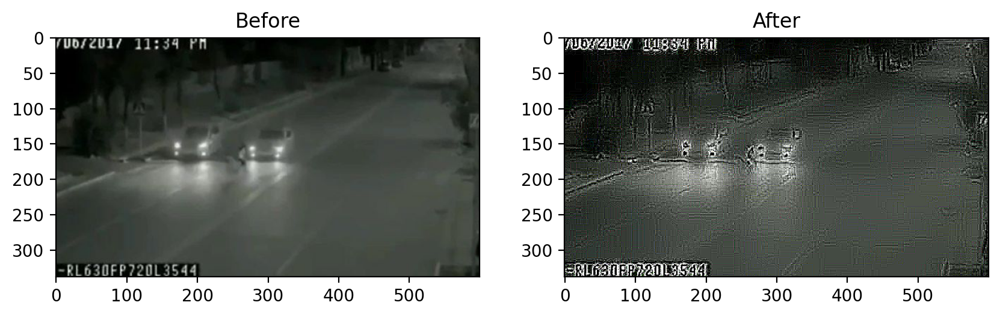

In [19]:
for i in range(6):
    fig, plots = plt.subplots(nrows=1, ncols=2, figsize=(10, 10), dpi=200)
    img = cv.imread(f"../lib/images/{i+5}.jpg")
    img = cv.cvtColor(img, cv.COLOR_BGR2RGB)

    details = cv.Laplacian(img, cv.CV_16S, 3)

    plots[0].imshow(img, cmap="gray")
    plots[0].set_title("Before")

    plots[1].imshow(img + 10 * details, cmap="gray")
    plots[1].set_title("After")

    plt.show()

---

## Problem 7

### (a)

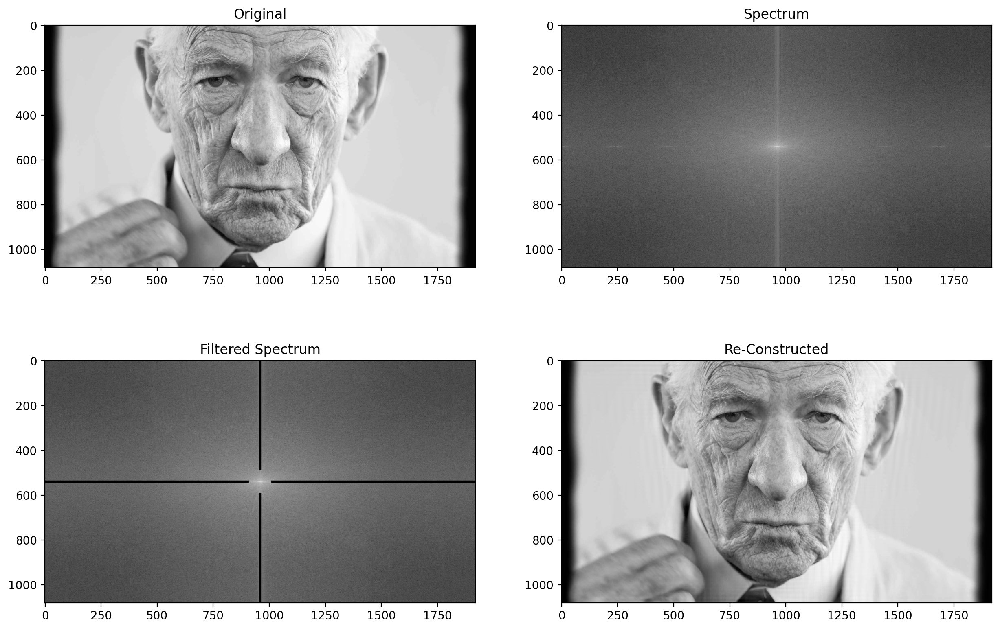

In [20]:
fig, plots = plt.subplots(nrows=2, ncols=2, figsize=(15, 10), dpi=200)
plots = plots.flatten()

img = cv.imread("../lib/images/11.jpg", cv.IMREAD_GRAYSCALE)

plots[0].imshow(img, cmap="gray")
plots[0].set_title("Original")

fft = np.fft.fftshift(np.fft.fft2(img))
plots[1].imshow(np.log(1 + np.abs(fft)).astype(int), cmap="gray")
plots[1].set_title("Spectrum")

x = int(fft.shape[0] / 2)
y = int(fft.shape[1] / 2)
fft[x-5:x+5, :y-50] = fft[x-5:x+5, y+50:] = 0
fft[:x-50, y-5:y+5] = fft[x+50:, y-5:y+5] = 0
plots[2].imshow(np.log(1 + np.abs(fft)).astype(int), cmap="gray")
plots[2].set_title("Filtered Spectrum")

plots[3].imshow(np.abs(np.fft.ifft2(np.fft.ifftshift(fft))), cmap="gray")
plots[3].set_title("Re-Constructed")

plt.show()

### (b)

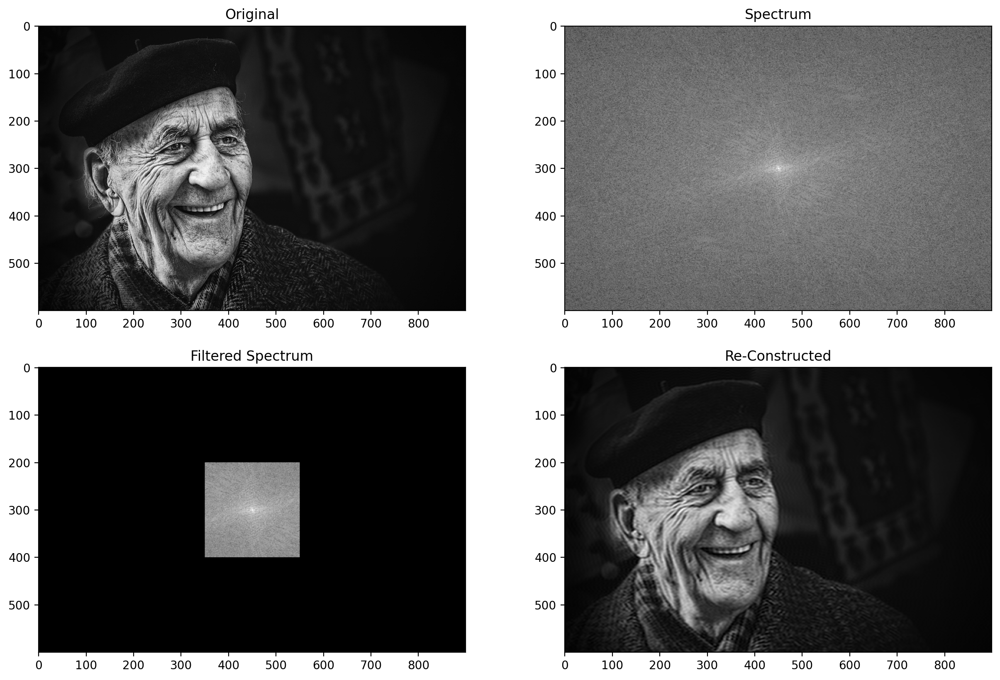

In [21]:
fig, plots = plt.subplots(nrows=2, ncols=2, figsize=(15, 10), dpi=200)
plots = plots.flatten()

img = cv.imread("../lib/images/12.jpg", cv.IMREAD_GRAYSCALE)

plots[0].imshow(img, cmap="gray")
plots[0].set_title("Original")

fft = np.fft.fftshift(np.fft.fft2(img))
plots[1].imshow(np.log(1 + np.abs(fft)).astype(int), cmap="gray")
plots[1].set_title("Spectrum")

x = int(fft.shape[0] / 2)
y = int(fft.shape[1] / 2)
fft2 = np.copy(fft)
fft2[x-100:x+100, y-100:y+100] = 0
fft = fft - fft2
plots[2].imshow(np.log(1 + np.abs(fft)).astype(int), cmap="gray")
plots[2].set_title("Filtered Spectrum")

plots[3].imshow(np.abs(np.fft.ifft2(np.fft.ifftshift(fft))), cmap="gray")
plots[3].set_title("Re-Constructed")

plt.show()

---